In [1]:
%run supportvectors-common.ipynb



<div style="color:#aaa;font-size:8pt">
<hr/>

 </blockquote>
 <hr/>
</div>



<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Exploratory-data-analysis-for-the-housing-dataset" data-toc-modified-id="Exploratory-data-analysis-for-the-housing-dataset-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Exploratory data analysis for the housing dataset</a></span><ul class="toc-item"><li><span><a href="#Styling-the-table-with-a-splash-of-color" data-toc-modified-id="Styling-the-table-with-a-splash-of-color-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Styling the table with a splash of color</a></span></li><li><span><a href="#Missing-Value-Analysis" data-toc-modified-id="Missing-Value-Analysis-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Missing Value Analysis</a></span></li><li><span><a href="#Drop-missing-values-for-now" data-toc-modified-id="Drop-missing-values-for-now-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Drop missing values for now</a></span></li><li><span><a href="#Draw-the-map-of-California" data-toc-modified-id="Draw-the-map-of-California-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Draw the map of California</a></span></li></ul></li><li><span><a href="#Basic-Regression-Model" data-toc-modified-id="Basic-Regression-Model-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Basic Regression Model</a></span><ul class="toc-item"><li><span><a href="#Data-Preprocessing" data-toc-modified-id="Data-Preprocessing-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Data Preprocessing</a></span></li><li><span><a href="#Log-transform" data-toc-modified-id="Log-transform-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Log transform</a></span></li><li><span><a href="#Data-split-into-train-and-test" data-toc-modified-id="Data-split-into-train-and-test-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Data split into train and test</a></span></li><li><span><a href="#Simple-linear-regression-model" data-toc-modified-id="Simple-linear-regression-model-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Simple linear regression model</a></span><ul class="toc-item"><li><span><a href="#Prediction-Errors-Plot" data-toc-modified-id="Prediction-Errors-Plot-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>Prediction Errors Plot</a></span></li><li><span><a href="#Cook's-Distance-to-see-point-of-high-influence-(leverage)" data-toc-modified-id="Cook's-Distance-to-see-point-of-high-influence-(leverage)-2.4.2"><span class="toc-item-num">2.4.2&nbsp;&nbsp;</span>Cook's Distance to see point of high influence (leverage)</a></span></li></ul></li><li><span><a href="#Would-regularlization-help?" data-toc-modified-id="Would-regularlization-help?-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Would regularlization help?</a></span><ul class="toc-item"><li><span><a href="#Prediction-Errors-Plot" data-toc-modified-id="Prediction-Errors-Plot-2.5.1"><span class="toc-item-num">2.5.1&nbsp;&nbsp;</span>Prediction Errors Plot</a></span></li></ul></li></ul></li></ul></div>

# Exploratory data analysis for the housing dataset

In [2]:
data = pd.read_csv("https://raw.githubusercontent.com/supportvectors/ml-100/master/housing.csv") # reading and storing the dataset in a pandas dataframe

In [3]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640,NaN,NaN,NaN,-119.57,2.00353,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20640,NaN,NaN,NaN,35.6319,2.13595,32.54,33.93,34.26,37.71,41.95
housing_median_age,20640,NaN,NaN,NaN,28.6395,12.5856,1,18,29,37,52
total_rooms,20640,NaN,NaN,NaN,2635.76,2181.62,2,1447.75,2127,3148,39320
total_bedrooms,20433,NaN,NaN,NaN,537.871,421.385,1,296,435,647,6445
population,20640,NaN,NaN,NaN,1425.48,1132.46,3,787,1166,1725,35682
households,20640,NaN,NaN,NaN,499.54,382.33,1,280,409,605,6082
median_income,20640,NaN,NaN,NaN,3.87067,1.89982,0.4999,2.5634,3.5348,4.74325,15.0001
median_house_value,20640,NaN,NaN,NaN,206856,115396,14999,119600,179700,264725,500001
ocean_proximity,20640,5,<1H OCEAN,9136,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Styling the table with a splash of color

In [4]:
(data.describe(include='all').transpose().style
    .set_table_styles(sv_table_styles()))


,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640.000000,nan,nan,nan,-119.569704,2.003532,-124.350000,-121.800000,-118.490000,-118.010000,-114.310000
latitude,20640.000000,nan,nan,nan,35.631861,2.135952,32.540000,33.930000,34.260000,37.710000,41.950000
housing_median_age,20640.000000,nan,nan,nan,28.639486,12.585558,1.000000,18.000000,29.000000,37.000000,52.000000
total_rooms,20640.000000,nan,nan,nan,2635.763081,2181.615252,2.000000,1447.750000,2127.000000,3148.000000,39320.000000
total_bedrooms,20433.000000,nan,nan,nan,537.870553,421.385070,1.000000,296.000000,435.000000,647.000000,6445.000000
population,20640.000000,nan,nan,nan,1425.476744,1132.462122,3.000000,787.000000,1166.000000,1725.000000,35682.000000
households,20640.000000,nan,nan,nan,499.539680,382.329753,1.000000,280.000000,409.000000,605.000000,6082.000000
median_income,20640.000000,nan,nan,nan,3.870671,1.899822,0.499900,2.563400,3.534800,4.743250,15.000100
median_house_value,20640.000000,nan,nan,nan,206855.816909,115395.615874,14999.000000,119600.000000,179700.000000,264725.000000,500001.000000
ocean_proximity,20640,5,<1H OCEAN,9136,nan,nan,nan,nan,nan,nan,nan


## Missing Value Analysis

Let us study the severity of missing values for each of the features.

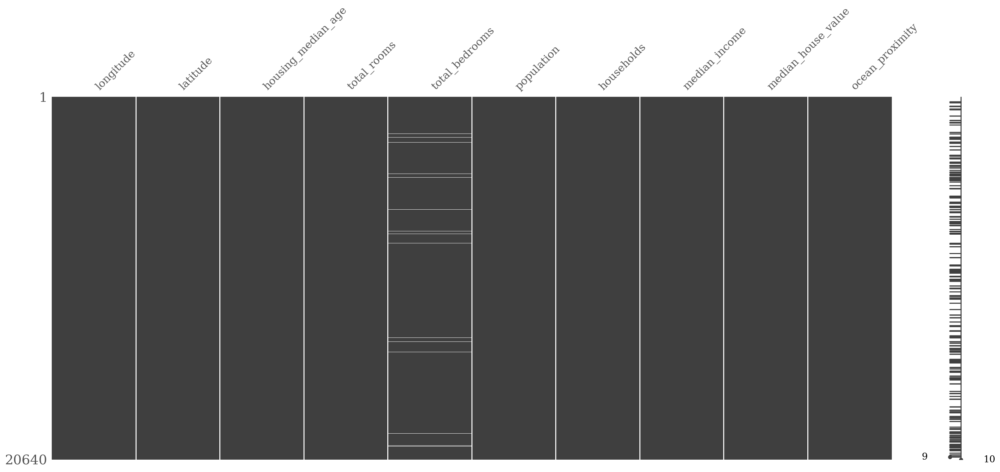

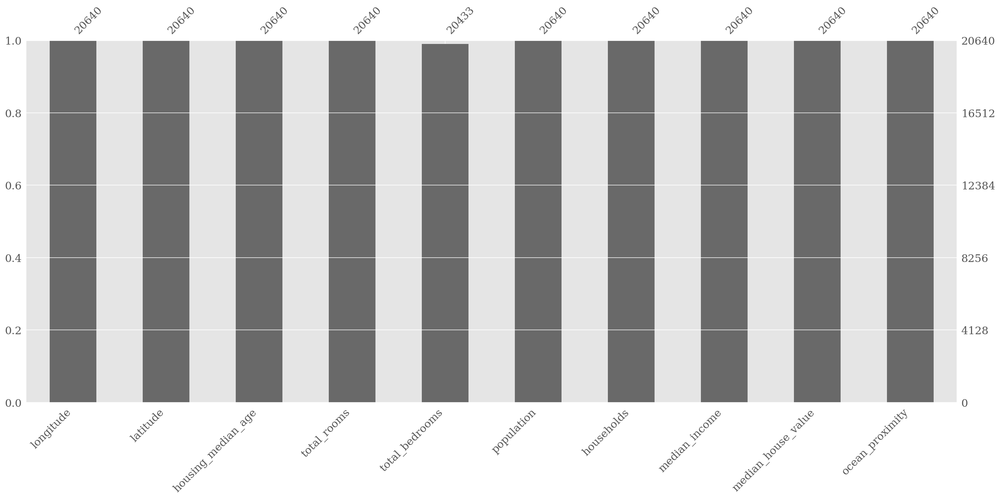

In [5]:
# Missingno library breaks with latex, so we will temporarily turn it off.
rc ('text', usetex=False)
import missingno as msno
msno.matrix(data);
plt.show()
msno.bar(data);
plt.show()


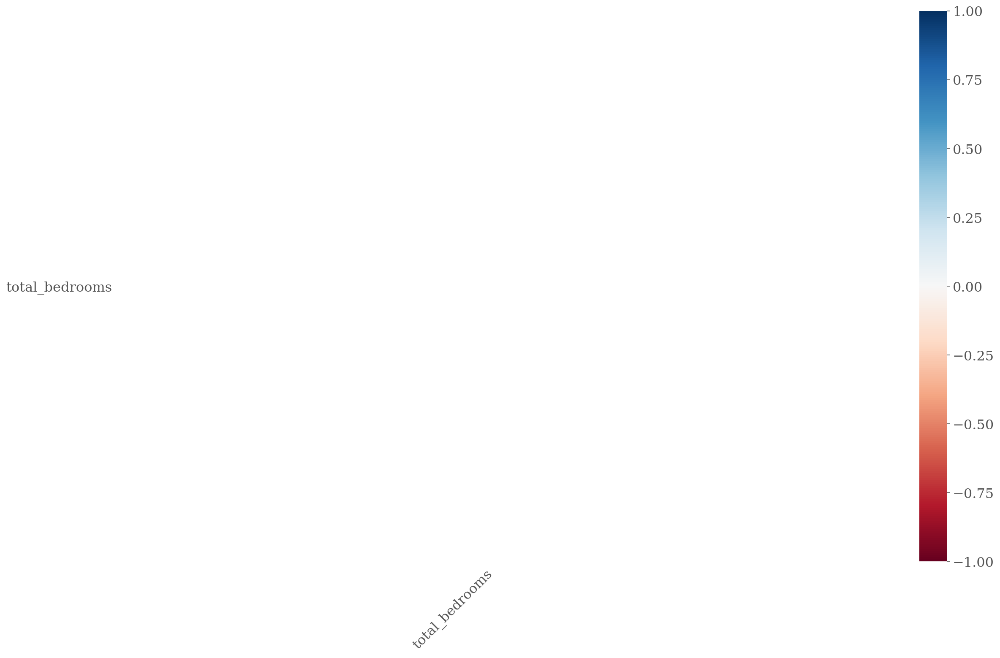

In [6]:
msno.heatmap(data);

<AxesSubplot:>

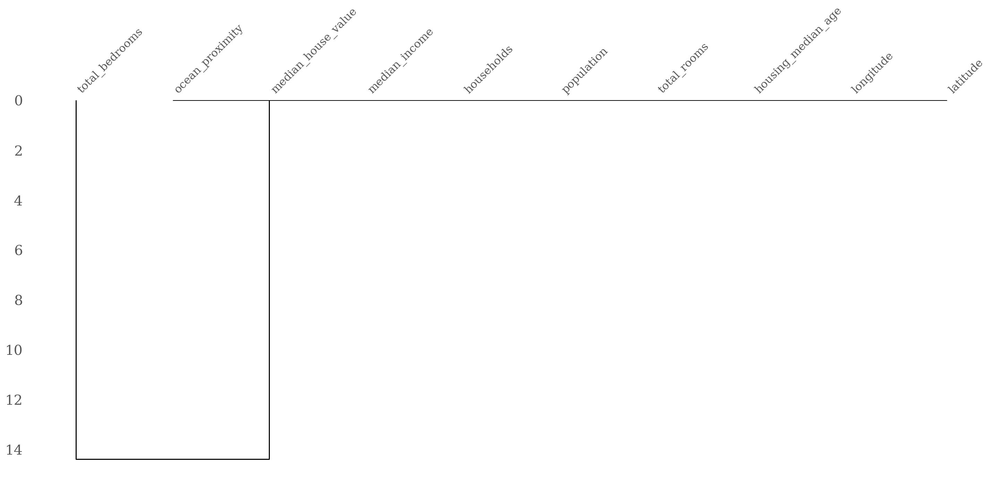

In [7]:
msno.dendrogram(data)

In [8]:
data.profile_report()

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Drop missing values for now

In [9]:
# Since very few rows have missing total-bedroom feature, let us drop those rows.

data.dropna(inplace=True)

In [10]:
rc ('text', usetex=False) # Re-enable it.

 ## Draw the map of California

In [11]:

import folium
plt.rcParams['figure.figsize'] = '20,20'

# Find the center of california
max_x, min_x      = data['longitude'].max(), data['longitude'].min()
max_y, min_y      = data['latitude'].max(), data['latitude'].min()
center_longitude, center_latitude   = (max_x+min_x)/2, (max_y+min_y)/2

# Plot the map of California
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=5.5)


for index, row in data.iterrows():
    folium.Circle(
    radius=3,
    location=[row.latitude, row.longitude],
    color='#E74C3C',
    opacity=0.05,
    fill=False,
    ).add_to(m)

m

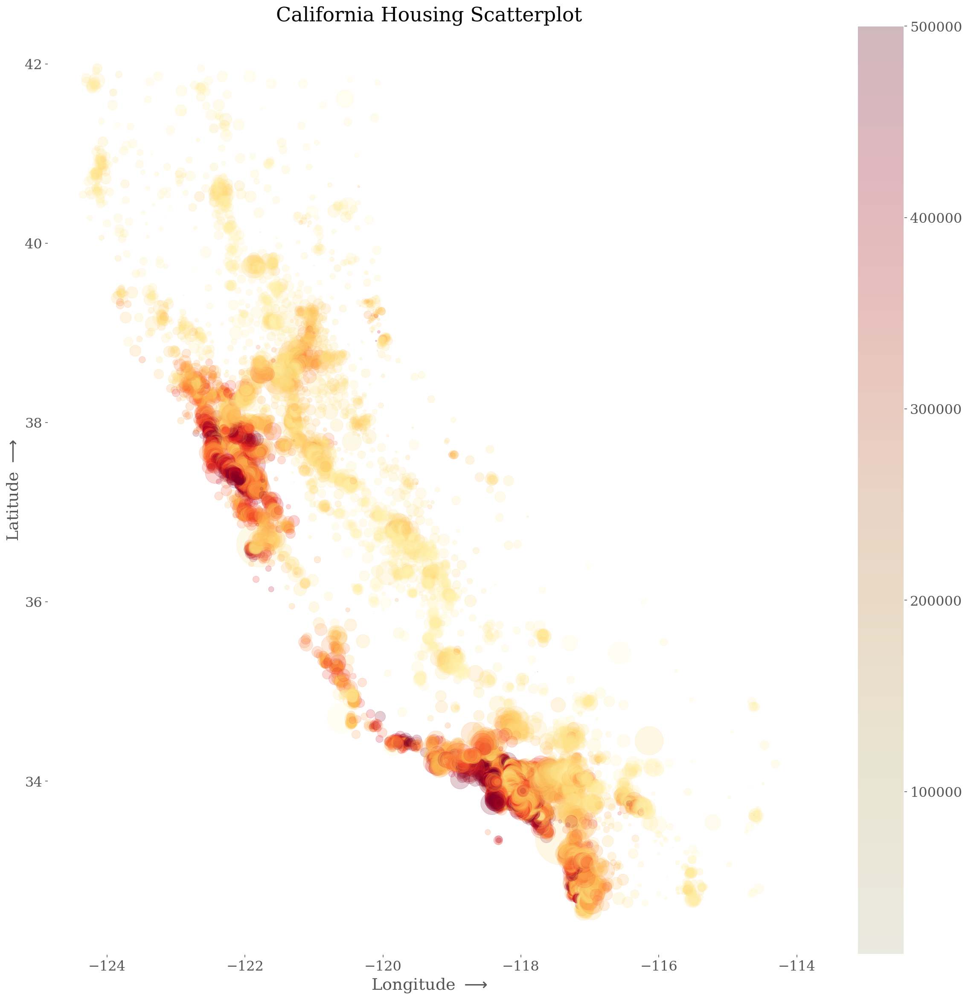

In [12]:



plt.scatter(x    = data.longitude, 
            y    = data.latitude, 
            c    = data.median_house_value, 
            cmap = 'YlOrRd', 
            s    = data.population/10, 
            alpha= 0.2);
ax = plt.gca();
ax.set_facecolor('#FFFFFF')
plt.xlabel(r'Longitude $\longrightarrow$')
plt.ylabel(r'Latitude $\longrightarrow$')
plt.title(r'California Housing Scatterplot')

plt.colorbar();

In [13]:
import matplotlib.image as mpimg

img1 = mpimg.imread('california-housing-map.png')
img2 = mpimg.imread('california-housing-scatterplot.png')

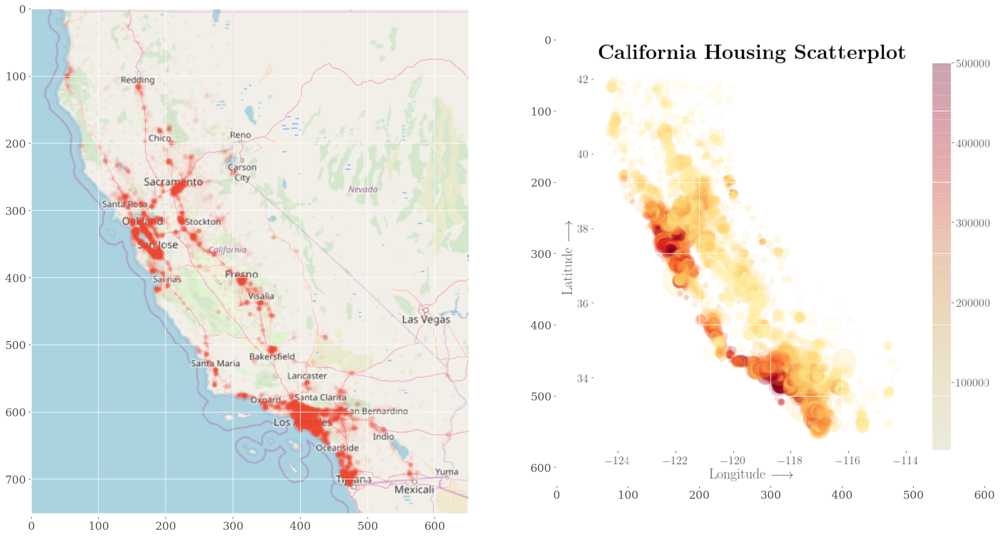

In [14]:
plt.rcParams['figure.figsize'] = '25,25'

plt.figure(1)
plt.title(r'\textbf{California Housing}')

plt.subplot(121);
plt.imshow(img1);

plt.subplot(122);
plt.imshow(img2);



In [15]:
data.ocean_proximity = data.ocean_proximity.astype('category')

In [16]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20433,NaN,NaN,NaN,-119.571,2.00358,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20433,NaN,NaN,NaN,35.6332,2.13635,32.54,33.93,34.26,37.72,41.95
housing_median_age,20433,NaN,NaN,NaN,28.6331,12.5918,1,18,29,37,52
total_rooms,20433,NaN,NaN,NaN,2636.5,2185.27,2,1450,2127,3143,39320
total_bedrooms,20433,NaN,NaN,NaN,537.871,421.385,1,296,435,647,6445
population,20433,NaN,NaN,NaN,1424.95,1133.21,3,787,1166,1722,35682
households,20433,NaN,NaN,NaN,499.433,382.299,1,280,409,604,6082
median_income,20433,NaN,NaN,NaN,3.87116,1.89929,0.4999,2.5637,3.5365,4.744,15.0001
median_house_value,20433,NaN,NaN,NaN,206864,115436,14999,119500,179700,264700,500001
ocean_proximity,20433,5,<1H OCEAN,9034,NaN,NaN,NaN,NaN,NaN,NaN,NaN


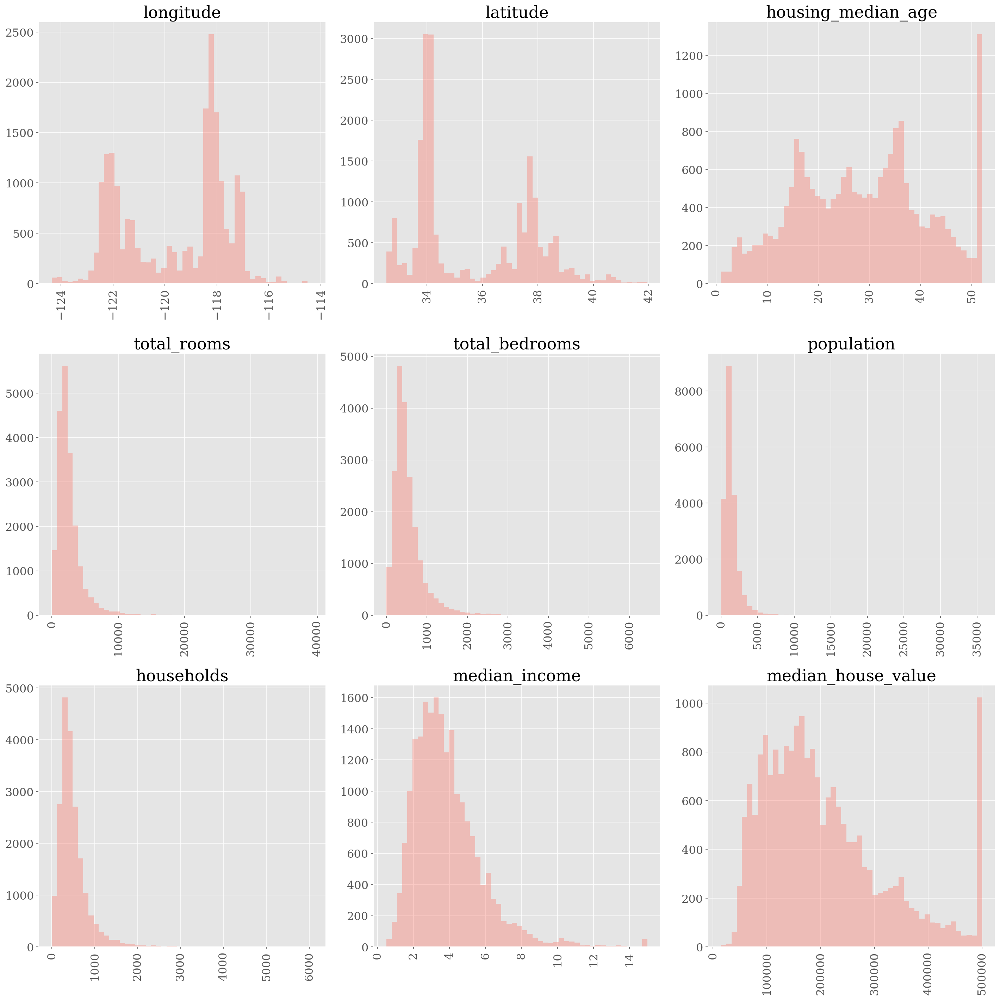

In [17]:
rc('text', usetex=False)
data.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20));
plt.tight_layout()

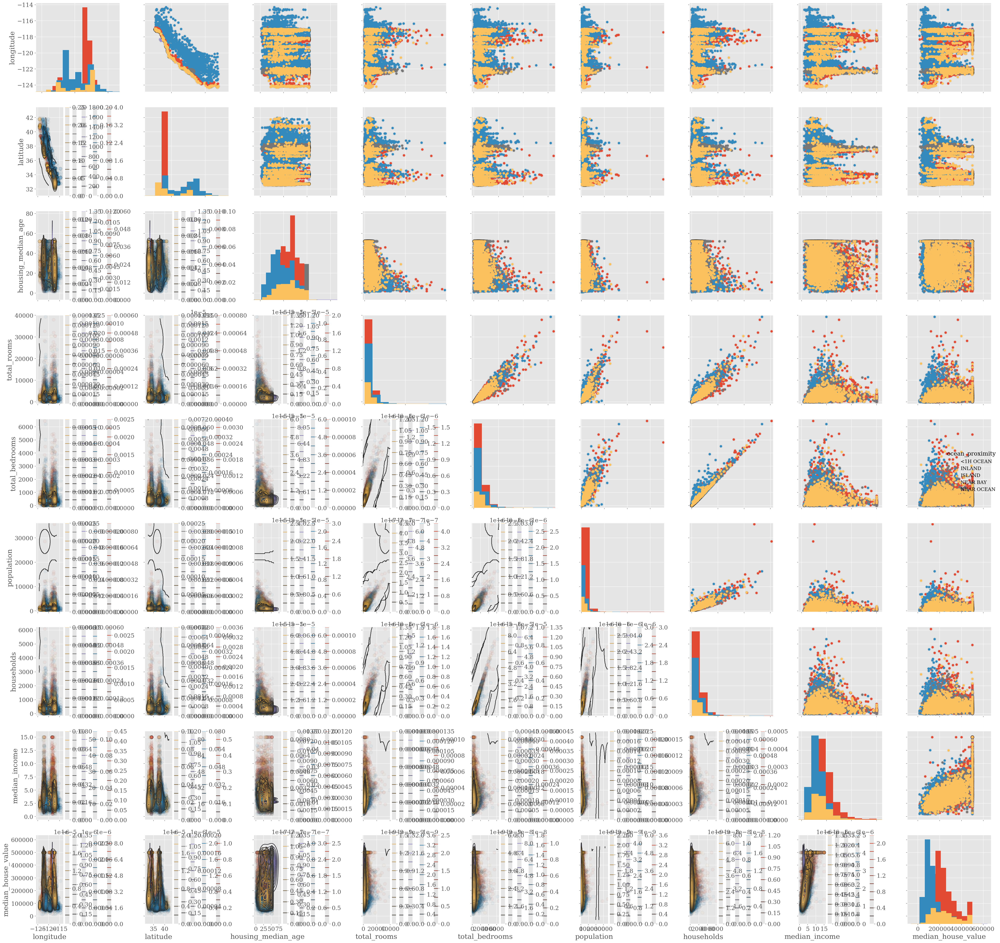

In [18]:

sample = data
fig = sns.pairplot(sample, 
                   plot_kws = {'alpha': 0.05, 's': 80, 'edgecolor': 'k'}, 
                   size=4, hue='ocean_proximity');
fig.map_diag(plt.hist);
fig.map_upper(plt.scatter);
fig.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);
plt.tight_layout()

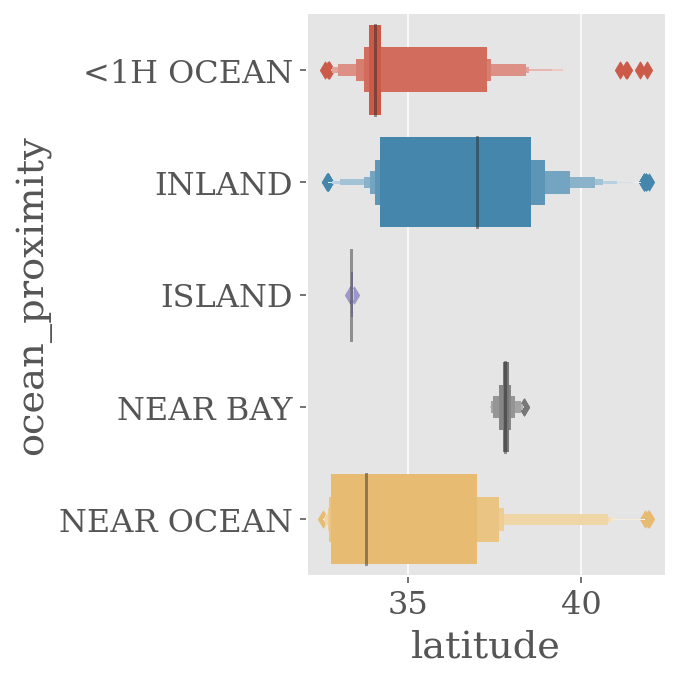

In [19]:
plt.rcParams['figure.figsize'] = '5,5'
sns.catplot(x="latitude", y="ocean_proximity", kind="boxen",
            data=data.sort_values("ocean_proximity"));

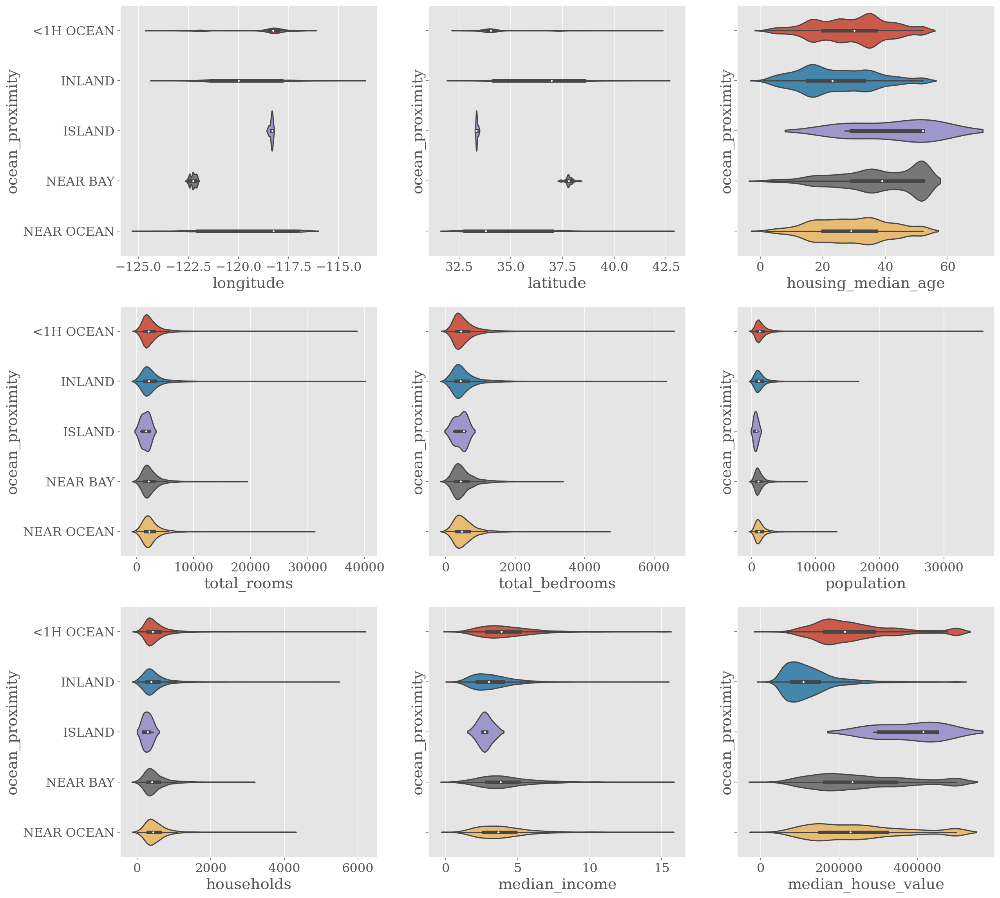

In [20]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

# Because there are 9 numerical features
fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))


for i in range(9):
    sns.violinplot(  y    = 'ocean_proximity', 
                     x    = features[i], 
                     data = data,ax=axes[int(i/3), i%3], figsize=(8,8))



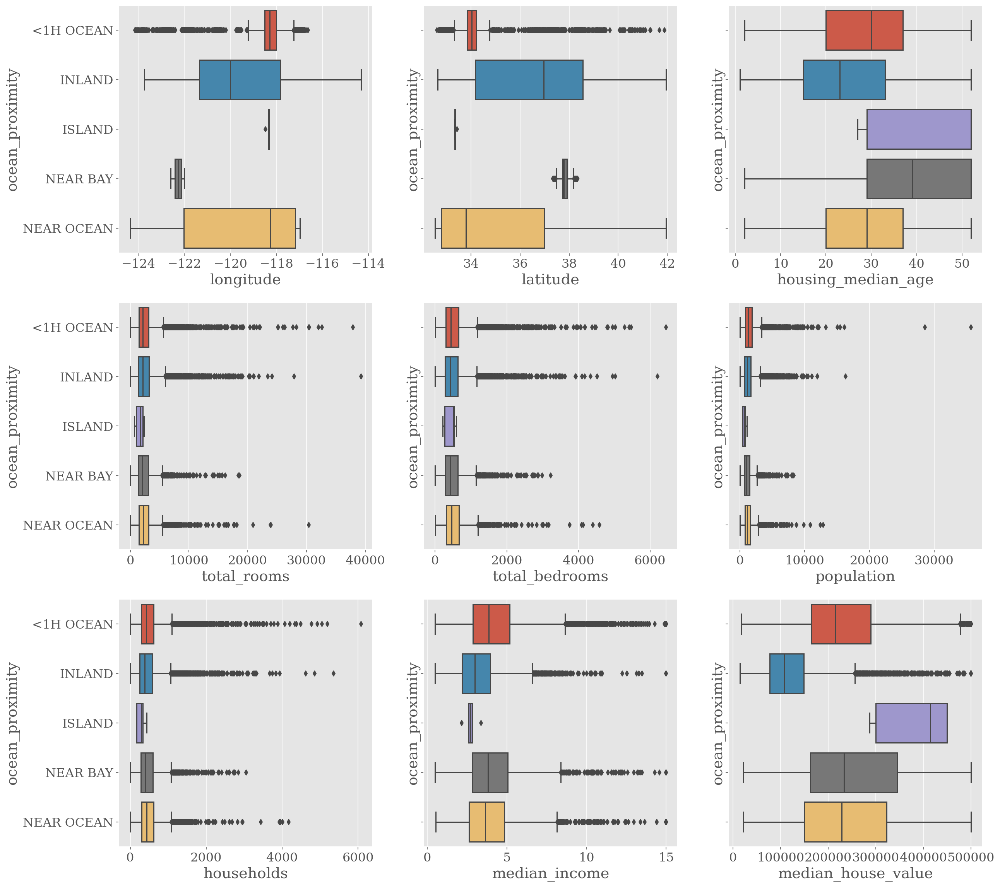

In [21]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))

for i in range(9):
    sns.boxplot(  y='ocean_proximity', x = features[i], data=data,ax=axes[int(i/3), i%3] )

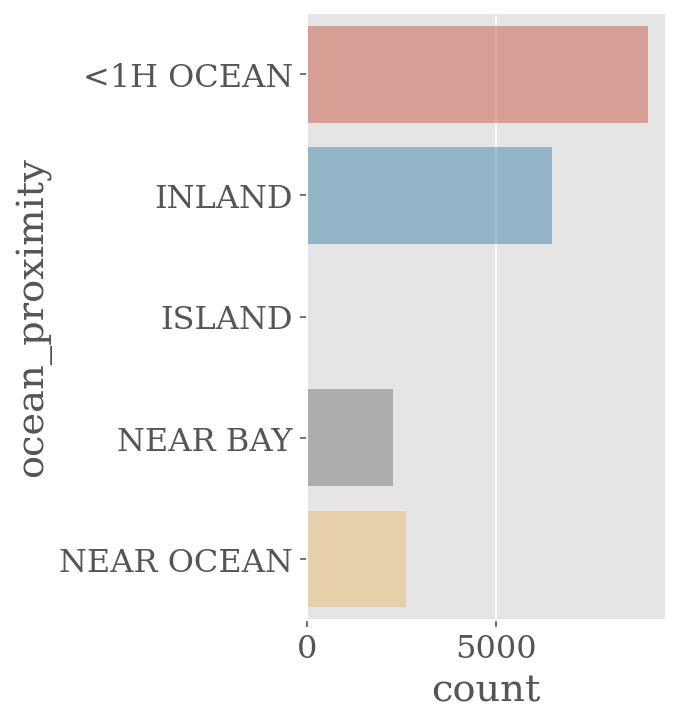

In [22]:
sns.catplot(y="ocean_proximity", kind="count",  alpha=0.5, data=data);

In [23]:
corr = data.corr()
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.924616,-0.109357,0.045480,0.069608,0.100270,0.056513,-0.015550,-0.045398
latitude,-0.924616,1.000000,0.011899,-0.036667,-0.066983,-0.108997,-0.071774,-0.079626,-0.144638
housing_median_age,-0.109357,0.011899,1.000000,-0.360628,-0.320451,-0.295787,-0.302768,-0.118278,0.106432
total_rooms,0.045480,-0.036667,-0.360628,1.000000,0.930380,0.857281,0.918992,0.197882,0.133294
total_bedrooms,0.069608,-0.066983,-0.320451,0.930380,1.000000,0.877747,0.979728,-0.007723,0.049686
population,0.100270,-0.108997,-0.295787,0.857281,0.877747,1.000000,0.907186,0.005087,-0.025300
households,0.056513,-0.071774,-0.302768,0.918992,0.979728,0.907186,1.000000,0.013434,0.064894
median_income,-0.015550,-0.079626,-0.118278,0.197882,-0.007723,0.005087,0.013434,1.000000,0.688355
median_house_value,-0.045398,-0.144638,0.106432,0.133294,0.049686,-0.025300,0.064894,0.688355,1.000000


In [24]:
# to get the latex output for the document.
print(corr.to_latex())

\begin{tabular}{lrrrrrrrrr}
\toprule
{} &  longitude &  latitude &  housing\_median\_age &  total\_rooms &  total\_bedrooms &  population &  households &  median\_income &  median\_house\_value \\
\midrule
longitude          &   1.000000 & -0.924616 &           -0.109357 &     0.045480 &        0.069608 &    0.100270 &    0.056513 &      -0.015550 &           -0.045398 \\
latitude           &  -0.924616 &  1.000000 &            0.011899 &    -0.036667 &       -0.066983 &   -0.108997 &   -0.071774 &      -0.079626 &           -0.144638 \\
housing\_median\_age &  -0.109357 &  0.011899 &            1.000000 &    -0.360628 &       -0.320451 &   -0.295787 &   -0.302768 &      -0.118278 &            0.106432 \\
total\_rooms        &   0.045480 & -0.036667 &           -0.360628 &     1.000000 &        0.930380 &    0.857281 &    0.918992 &       0.197882 &            0.133294 \\
total\_bedrooms     &   0.069608 & -0.066983 &           -0.320451 &     0.930380 &        1.000000 &    0.877747 &

In [25]:
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.924616,-0.109357,0.045480,0.069608,0.100270,0.056513,-0.015550,-0.045398
latitude,-0.924616,1.000000,0.011899,-0.036667,-0.066983,-0.108997,-0.071774,-0.079626,-0.144638
housing_median_age,-0.109357,0.011899,1.000000,-0.360628,-0.320451,-0.295787,-0.302768,-0.118278,0.106432
total_rooms,0.045480,-0.036667,-0.360628,1.000000,0.930380,0.857281,0.918992,0.197882,0.133294
total_bedrooms,0.069608,-0.066983,-0.320451,0.930380,1.000000,0.877747,0.979728,-0.007723,0.049686
population,0.100270,-0.108997,-0.295787,0.857281,0.877747,1.000000,0.907186,0.005087,-0.025300
households,0.056513,-0.071774,-0.302768,0.918992,0.979728,0.907186,1.000000,0.013434,0.064894
median_income,-0.015550,-0.079626,-0.118278,0.197882,-0.007723,0.005087,0.013434,1.000000,0.688355
median_house_value,-0.045398,-0.144638,0.106432,0.133294,0.049686,-0.025300,0.064894,0.688355,1.000000


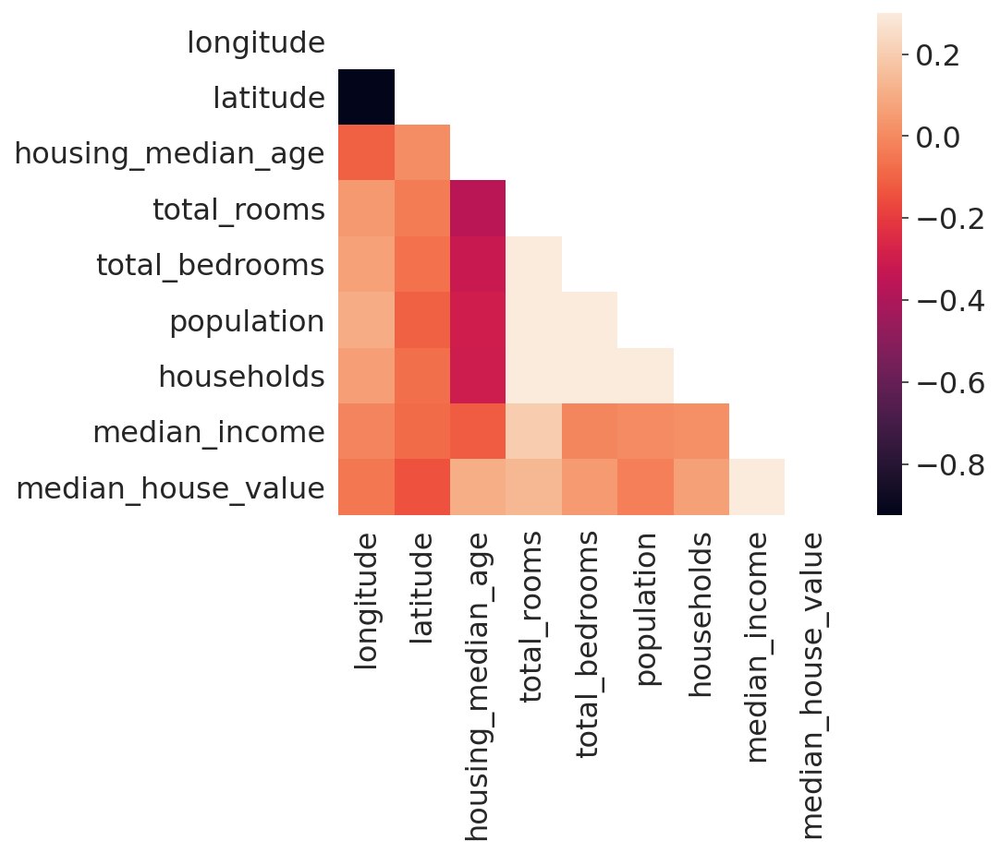

In [26]:
import numpy as np
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(7, 5))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

# Basic Regression Model

Let us now build a regression model using RandomForest for the housing dataset. To do this, let us first prepare teh dataset for analysis

## Data Preprocessing

Here we perform the two steps:
* convert the categorical to one-hot encoding
* drop the missing values
* extract out the feature-space X, and the target (label) variable. 

In [27]:
data_one_hot = pd.get_dummies(data, 
                              columns=['ocean_proximity'], 
                              prefix = ['ocean_proximity'])
data_one_hot.dropna(inplace=True) 
y = data_one_hot.median_house_value
X = data_one_hot.drop('median_house_value', axis=1)

X.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
longitude,20433.0,-119.570689,2.003578,-124.3500,-121.8000,-118.4900,-118.010,-114.3100
latitude,20433.0,35.633221,2.136348,32.5400,33.9300,34.2600,37.720,41.9500
housing_median_age,20433.0,28.633094,12.591805,1.0000,18.0000,29.0000,37.000,52.0000
total_rooms,20433.0,2636.504233,2185.269567,2.0000,1450.0000,2127.0000,3143.000,39320.0000
total_bedrooms,20433.0,537.870553,421.385070,1.0000,296.0000,435.0000,647.000,6445.0000
population,20433.0,1424.946949,1133.208490,3.0000,787.0000,1166.0000,1722.000,35682.0000
households,20433.0,499.433465,382.299226,1.0000,280.0000,409.0000,604.000,6082.0000
median_income,20433.0,3.871162,1.899291,0.4999,2.5637,3.5365,4.744,15.0001
ocean_proximity_<1H OCEAN,20433.0,0.442128,0.496652,0.0000,0.0000,0.0000,1.000,1.0000
ocean_proximity_INLAND,20433.0,0.317917,0.465678,0.0000,0.0000,0.0000,1.000,1.0000


## Log transform
We noticed before that some of the features show a strong right skew. In order to address it, let us take a log-transform in order to try to make them look a bit more symmetrical.

In [28]:
X.total_bedrooms = np.log(X.total_bedrooms)
X.population = np.log(X.population)
X.total_rooms = np.log(X.total_rooms)
X.households = np.log(X.households)
X.median_income = np.log(X.median_income)
y = np.log(y)
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
longitude,20433.0,-119.570689,2.003578,-124.350000,-121.800000,-118.490000,-118.010000,-114.310000
latitude,20433.0,35.633221,2.136348,32.540000,33.930000,34.260000,37.720000,41.950000
housing_median_age,20433.0,28.633094,12.591805,1.000000,18.000000,29.000000,37.000000,52.000000
total_rooms,20433.0,7.628742,0.751814,0.693147,7.279319,7.662468,8.052933,10.579489
total_bedrooms,20433.0,6.051063,0.732785,0.000000,5.690359,6.075346,6.472346,8.771060
population,20433.0,7.023732,0.738632,1.098612,6.668228,7.061334,7.451242,10.482402
households,20433.0,5.980637,0.733216,0.000000,5.634790,6.013715,6.403574,8.713089
median_income,20433.0,1.244626,0.470637,-0.693347,0.941452,1.263138,1.556881,2.708057
ocean_proximity_<1H OCEAN,20433.0,0.442128,0.496652,0.000000,0.000000,0.000000,1.000000,1.000000
ocean_proximity_INLAND,20433.0,0.317917,0.465678,0.000000,0.000000,0.000000,1.000000,1.000000


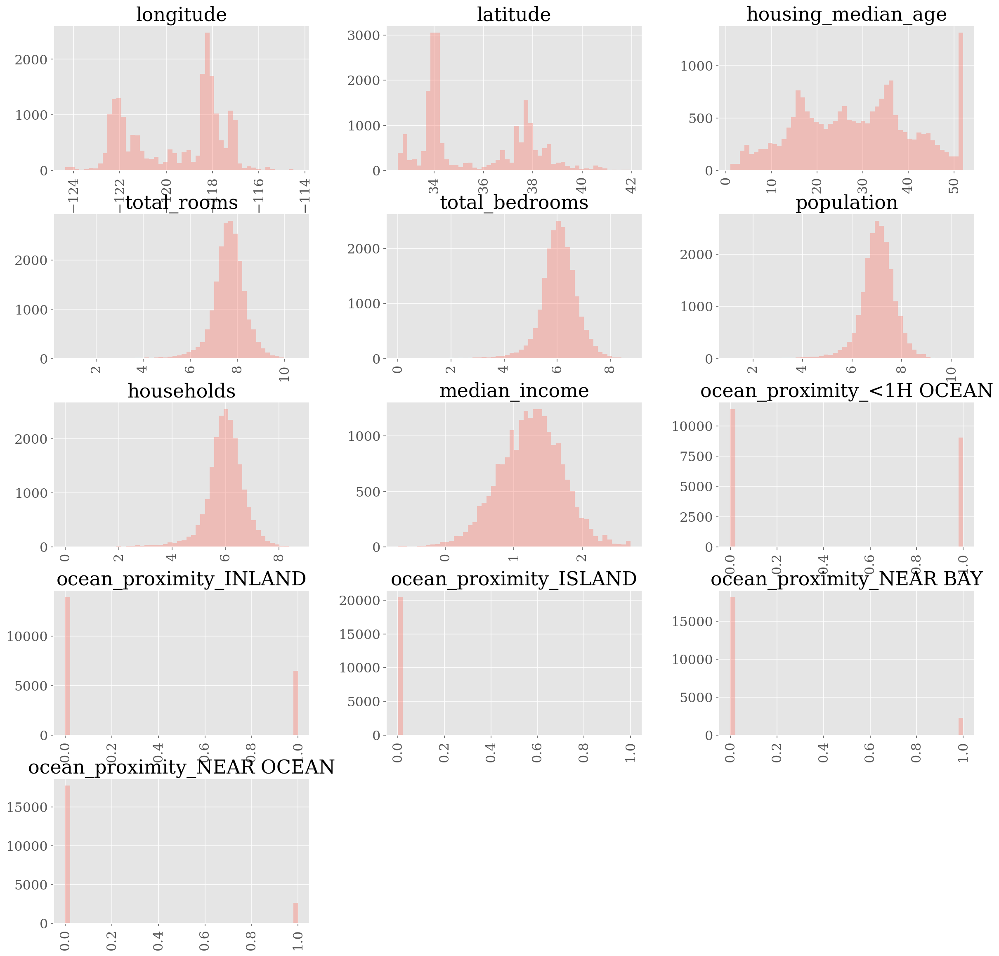

In [29]:
rc('text', usetex=False)
X.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20), layout=(5,3));

## Data split into train and test

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0, )

## Simple linear regression model 

Let us build a baseline linear regression model with this data:

In [31]:

linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
labels = linear_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {linear_model.coef_}')


Mean squared error: 0.10
Coefficient of Determination (R^2):0.6911
Model coefficients are: [-0.16538399 -0.16407788  0.00301923 -0.19099691  0.41382609 -0.37242703
  0.16891577  0.76365496 -0.05401582 -0.3199041   0.57082991 -0.09627221
 -0.10063778]


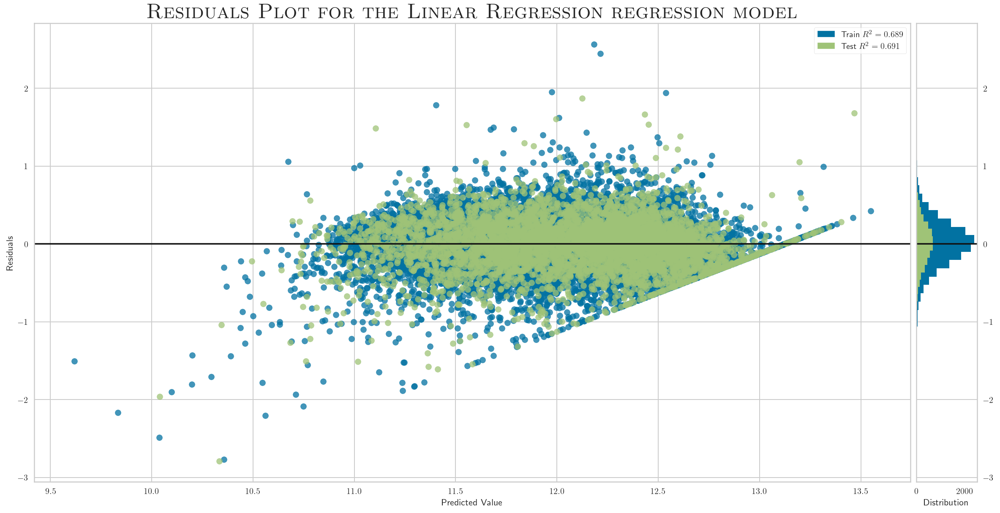

In [32]:
rc ('text', usetex=True) # Enable it selectively
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(linear_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Linear Regression regression model}')

### Prediction Errors Plot

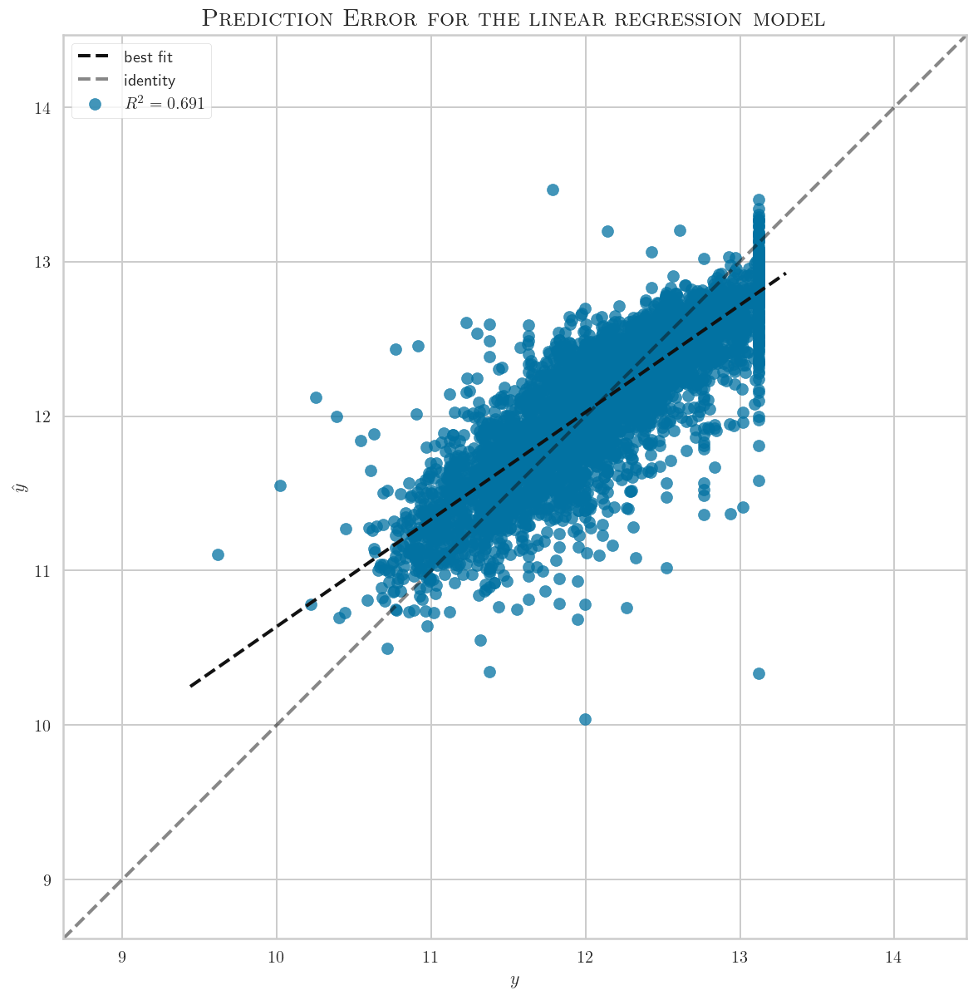

In [33]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(linear_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the linear regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

### Cook's Distance to see point of high influence (leverage)

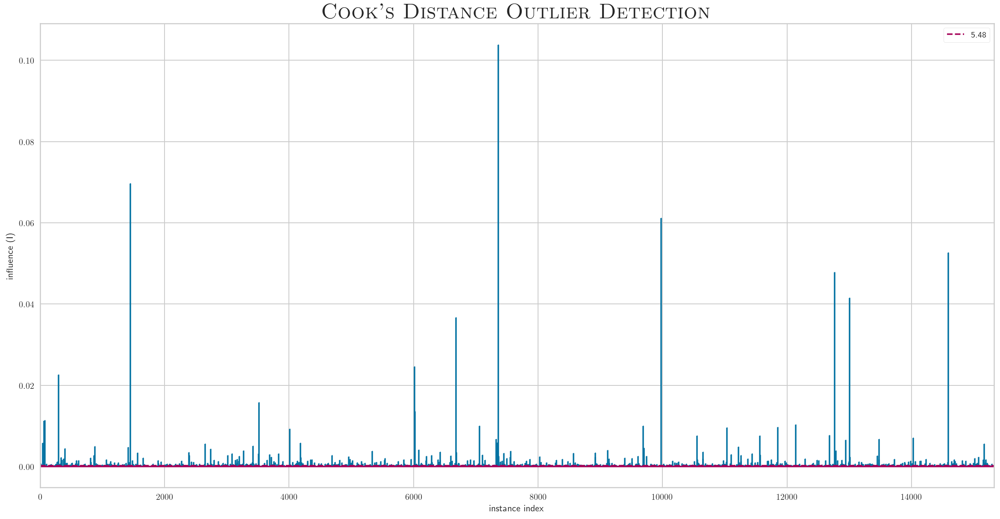

CooksDistance(ax=<AxesSubplot:title={'center':"\\textsc{\\Huge Cook's Distance Outlier Detection}"}, xlabel='instance index', ylabel='influence (I)'>)

In [34]:
from yellowbrick.regressor import cooks_distance
cooks_distance(
    X_train, y_train,
    draw_threshold=True,
    linefmt="C0-", markerfmt=",",
    title=r"\textsc{\Huge Cook's Distance Outlier Detection}"
    
)

## Would regularlization help?
Would regularizaton using say Ridge-Regularization for the regression give us a better result?

In [35]:
from sklearn.linear_model import RidgeCV
ridge_model = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1]).fit(X_train, y_train)

labels = ridge_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {ridge_model.coef_}')

Mean squared error: 0.10
Coefficient of Determination (R^2):0.6912
Model coefficients are: [-0.1654036  -0.16410165  0.0030193  -0.19076031  0.4136164  -0.37241136
  0.1688773   0.76352731 -0.05030601 -0.31620123  0.55599364 -0.09255258
 -0.09693382]


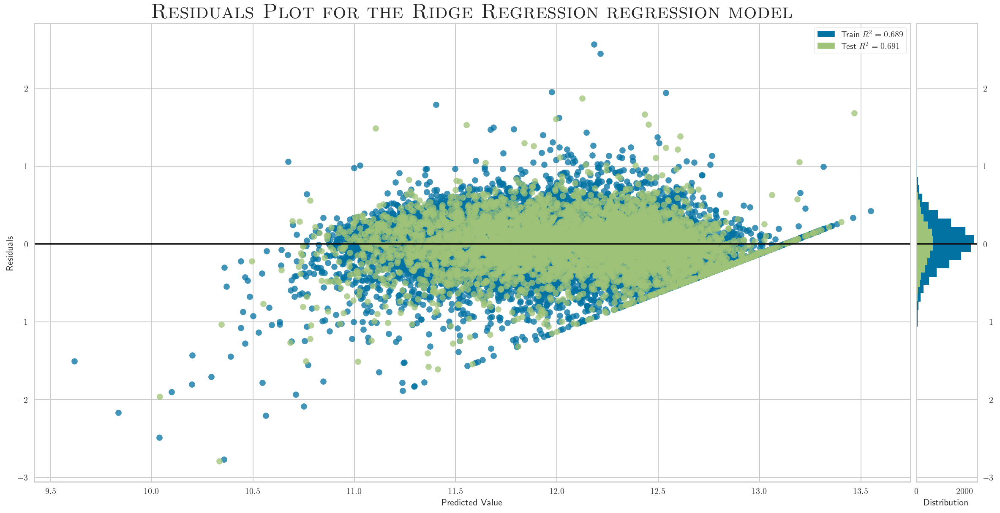

In [36]:
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(ridge_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Ridge Regression regression model}')

### Prediction Errors Plot

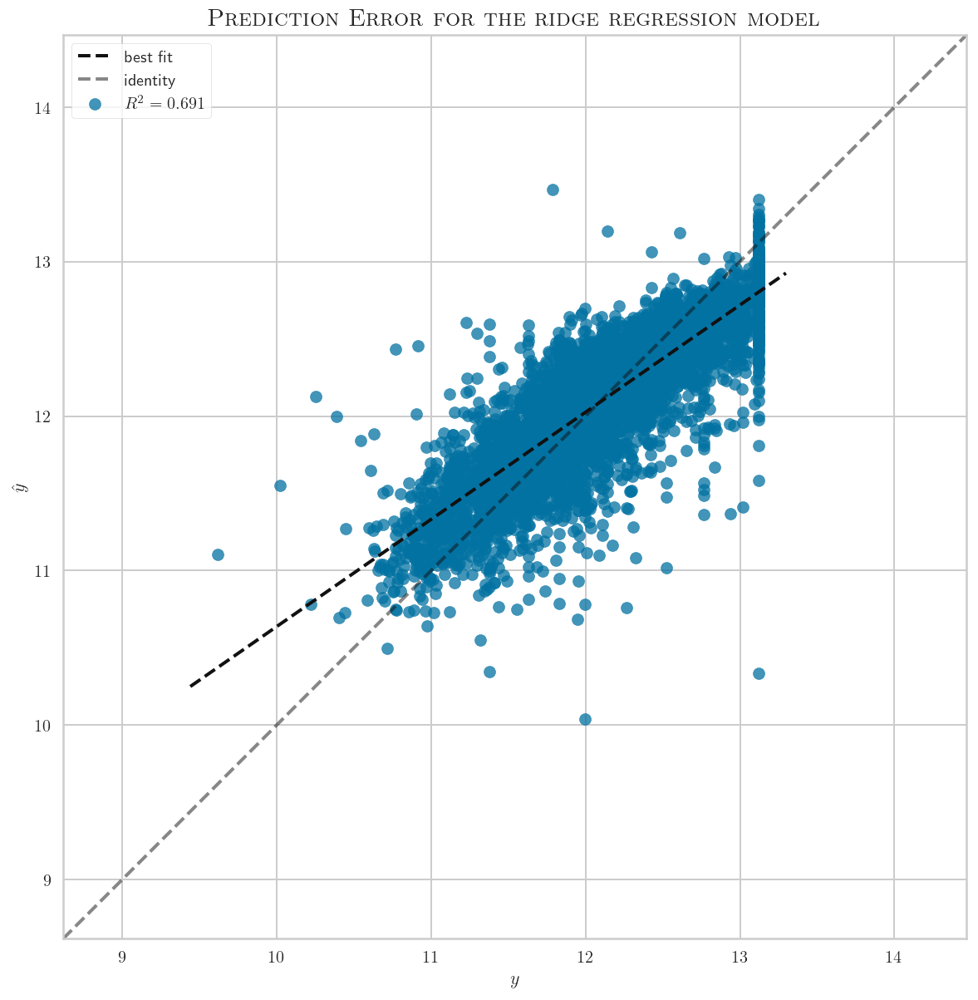

In [37]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(ridge_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the ridge regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')